# Capturing Many Faces

R. Thora Bjornsdottir [](https://orcid.org/0000-0002-1016-3829) (University of Stirling)  
Vít Třebický [](https://orcid.org/0000-0003-1440-1772) (Charles University)  
Lisa DeBruine [](https://orcid.org/0000-0002-7523-5539) (University of Glasgow)

In [ ]:
library(tidyverse)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   4.0.0     ✔ tibble    3.2.1
✔ lubridate 1.9.4     ✔ tidyr     1.3.1
✔ purrr     1.0.4     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


Attaching package: 'flextable'

The following object is masked from 'package:purrr':

    compose

In [ ]:
# OLD CHUNK -- KEEP FOR NOW WHILE I'M UPDATING, DELETE ONCE FINISHED
# read in main data used

# Model data
ct <- cols(
  age = col_integer(),
  height = col_integer(),
  weight = col_integer(),
  ethnicity_rec = col_factor(levels = c("White", "Black", "Asian", "Indigenous", "MENA", "Latine", "Mixed", "Ambiguous label"), include_na = TRUE)
)
data_models <- read_csv("data/manyfaces-pilot-models_cleaned.csv",
                        col_types = ct)

# Rating data (post exclusions)
exp_levels <- c("attractive", 
                "dominant", 
                "trustworthy", 
                "attractive (unstd)", 
                "dominant (unstd)", 
                "trustworthy (unstd)",
                "memorable",
                "gender-typical",
                "age",
                "anger",
                "disgust", 
                "fear", 
                "happiness", 
                "sadness", 
                "surprise",
                "emotion 1", 
                "emotion 2", 
                "emotion 3", 
                "emotion 4", 
                "emotion 5", 
                "emotion 6"
              )
ct <- cols(
  exp = col_factor(levels = exp_levels)
)
data_exp <- read_csv("data/manyfaces-pilot-exp_cleaned.csv",
                     col_types = ct)

# Questionnaire data (post exclusions)
data_qu <- read_csv("data/manyfaces-pilot-quest_cleaned.csv",
                    show_col_types = FALSE)

# Exclusions
data_excl <- read_csv("data/exclusions.csv",
                    show_col_types = FALSE)

## Introduction

Faces are rich sources of information, playing a key role in human social perception. They strongly draw attention, serving as a primary means of person recognition and informing social inferences \[e.g., @freeman_more_2016; @sutherland_understanding_2022; @young_recognizing_2017; @zebrowitz_reading_1997\]. Various subfields within psychology—including vision science, person perception, social cognition, affective science, cognitive neuroscience, behavioural science, and person recognition—address research questions involving faces and thus necessitate the use of face images as stimuli. Here, we introduce a novel face image database for research use. This database was collected as part of an international multi-lab collaboration and addresses various limitations of existing databases. Crucially, we take a transparent approach aligned with Open Science best practices and make openly available the reproducible protocol we followed to collect the images, enabling future expansion of the database.

### Existing face databases

A wealth of face stimulus databases exists, created for various purposes. Many of these are available \[see e.g., @workman_face_2021 face image meta-database to search many of these\] for research purposes allowing access to a broad variety of face stimuli, well-suited to address questions in a given subfield. For example, there are many different databases in which photographed individuals (referred to as targets or models) display different facial expressions of emotion \[e.g., @ebner_facesdatabase_2010; @van_der_schalk_moving_2011, of use in affective science\], appear in varying lighting and angles \[e.g., @burton_glasgow_2010; @gao_cas-peal_2008, useful for person recognition research\], or belong to various age or racial/ethnic groups (for perception researcher). However, many studies tend to rely on a small number of those stimulus databases, which introduces potential problems. For example, 4107 published papers cite the Karolinska Directed Emotional Faces \[@lundqvist_karolinska_2015\], 4375 cite the NimStim Set of Facial Expressions \[@tottenham_nimstim_2009\], 2461 cite the Chicago Face Database \[@ma_chicago_2015\], and 3219 the Radboud Faces Database \[@langner_presentation_2010\]. Although citation counts are not a direct measure of the use of these databases, they nonetheless indicate their popularity. This frequent (over)use of the same sets of stimuli can compromise generalizability when various research questions are tested on only a limited sample of face images from specific backgrounds \[@debruine_reproducible_2022; @yarkoni_generalizability_2022\]. Participants, especially those participating online, may also become familiar with frequently used stimuli, potentially introducing biases to their responses.

Of course, not all research involving face images uses stimuli from published databases. It is a common for researchers to purposefully collect images themselves. But these stimulus sets are seldom openly shared (e.g., due to ethical limitations). Although this circumvents the issues with frequently-used databases, it introduces its own set of problems. Chiefly, face images collected by researchers for their own research use are often insufficiently documented. Although the resulting images may be described and/or illustrated with an example, the process of image collection is rarely described in adequate detail. This is often the case for even those databases openly available for research use. This lack of image acquisition (and processing) methods documentation limits transparency, replication attempts–for example, another researcher attempting to replicate a finding using new face images collected themselves, rather than the images collected by the original researchers \[see @trebicky_grim_2024\]–and assessments of results’ validity (as undercharacterization of stimuli can preclude identification of issues like confounding factors). Furthermore, different research teams often employ protocols that can differ significantly from each other in a plethora of major and minor details, including hair (e.g., free hairstyle or pulled back; facial hair allowed or not), facial accessories, makeup, lightning conditions, and type of shirt worn. These often-unreported details further hinder the comparison between different studies.

In many databases (both publicly available and not), there are also limitations in the diversity of stimuli. For example, many include only images of individuals who self-identify as White or Western \[e.g., see @cook_why_2021 see also @martinez_facecraft_2025 for a discussion of the potential reification of race in face research\]. This reinforces the centering of Whiteness and Western culture in psychological research, importantly limiting the ecological validity and generalizability of conclusions \[see also @henrich_weirdest_2010; roberts_challenging_2023\]. Recently created databases have sought to address this, specifically collecting images of multiracial/multi-ethnic and non-Western samples, for example \[e.g., @bastanfard_iranian_2007; @chen_broadening_2021; @courset_caucasian_2018; @meyers_hawaii_2024; @saribay_bogazici_2018; @trzewik_israeli_2025\], but more such work is needed to further diversify the pool of available face research stimuli. Many world regions and ancestries remain underrepresented (e.g. East African, First Nations, Australian Aboriginal people). This may be due, in part, to resource limitations: Equipment and setups for collecting images suitable for research use can be prohibitively expensive and complex, making database collection not feasible for everyone and everywhere, thereby limiting database diversity. Additionally, researchers with the necessary equipment may be limited in terms of the diversity of their available participant sample in terms of ancestry and cultural heritage that may shape visible facial features. Furthermore, to date, no extant database contains images of individuals from *multiple* world regions.

A final limitation of extant face image databases is their largely fixed state. That is, once collected, the number of stimuli available does not change. There are some exceptions to this, such as multiple waves of additions to the Chicago Face Database \[@lakshmi_india_2021; @ma_chicago_2021\]. Continued additions to databases are not the norm, however. This not only constrains the number of stimuli in any given database, increasing the likelihood of the frequent reuse of any individual stimulus, but can also render some databases obsolete over time (e.g., due to very dated model appearance/styling).

### Open Science considerations

Open and transparent methods are essential for fully understanding, evaluating, and replicating research. Although methods reporting has become more open and accessible with researchers sharing materials such as questionnaire wording, stimuli, and programming scripts, the reporting of face image database collection procedures often lacks crucial details for full transparency and reproducibility. This matters because differences in often-undocumented details such as focal length, for example, can importantly affect faces’ appearance, subsequently impacting perceptions of them \[e.g., @trebicky_focal_2016; see @trebicky_grim_2024 for further discussion\].

Big Team Science (i.e., multi-lab) endeavours and large-scale collaborations are now recognized as a vital part of improving science. Within psychology, multiple such initiatives have importantly contributed to addressing a variety of research questions, improving diversity and generalizability in the field (e.g., in the domain of face perception, Jones et al.’s \[-@jones_which_2021\] Psychological Science Accelerator project). Such an approach has yet to be applied to stimulus database collection, but it represents an opportunity to address many of the limitations of face image databases raised.

### The current work

Here, we sought to address the limitations of existing face image databases through a Big Team Science approach. This served as the first project of ManyFaces, an international consortium of face perception and recognition researchers formed in 2022.

To address transparency and reproducibility issues, we developed an openly available, reproducible protocol for face image collection. The protocol covers collecting multiple images (varying in standardization, viewing angle, and facial expression) of each target/model to benefit a wide array of possible research areas and questions related to face perception and recognition. Following this protocol, we collected images (Phase 1) in 20 different labs across the world, spanning 11 countries and five world regions (Europe, Latin America, North America, the Middle East, and Southeast Asia). This resulted in a diverse set of models and images, more than would be possible to collect in or by a single lab. Moreover, this database is not static but can be added to in the future by any interested researcher following the protocol. We also validated the database (Phase 2) by recruiting online perceivers to rate a subset of the images (i.e., front-facing images) to generate norming data for key social trait perceptions and emotion recognition. We make this image database and norming data available for future research.

Altogether, we introduce a new, diverse, openly-available face stimulus set that cancontinue to grow in the future. We believe that this effort will broaden the generalizability of findings in face perception and recognition research.

## Study/phase 1: Protocol development & stimulus collection

To set face perception and recognition Big Team Science in motion and enable conducting multi-site studies, a set of stimuli suitable for most areas (e.g., in terms of research question, geographic location) is needed. Therefore, we developed a protocol allowing us to collect such a database of face images. We developed the protocol with maximum usability and accessibility in mind, making it transparent and readable to non-experts, and designed for use with attainable (vs. highly specialized and expensive) equipment, with minimal setup requirements, and without requiring expertise in photography. Note that the protocol is for in-lab image collection to minimize external noise, to enable the collection of models’ self-report data, and to ensure the consensual use of models’ images (vs. scraping images from online sources or generating them). Photographing faces in a controlled lab environment thus strikes a balance in terms of ecological validity and ethical concerns \[see @trzewik_israeli_2025 for discussion of the value of lab-photographed vs. artificially generated and ambient face images\].

### Method

For both studies/phases, the University of Glasgow provided ethical approval. We obtained additional local ethical approval at collaborating institutions where required.

#### Protocol Development

The team curated a set of equipment and developed a protocol for collecting standardized, reproducible images of faces for research. Following a survey among the ManyFaces members[1], we constructed the protocol for the collection of a variety of images that would be useful for a broad variety of research questions. Specifically, we included images varying in their standardization of appearance (standardized and unstandardized, e.g., white t-shirt and hair pulled back vs. clothing and hair as worn by the participant/model on that day), viewing angle (frontal, profile, ¾), and facial expression (neutral, natural, angry, disgusted, fearful, happy, sad, surprised).

Prior to beginning data collection, the ManyFaces team pre-tested the protocol to ensure clarity of instructions and consistency of images collected across sites. We revised the protocol to address issues that arose (e.g., revised facial expression elicitation instructions, clarified camera settings). The final protocol can be found at \[https://docs.google.com/document/d/1D9TPGXCgTRZi7nqEIg6jb42R4gNQx9L3qasg8tFvu1I/edit?usp=sharing<!--to add to OSF-->\] (note that this is a living document that may be updated in future). In sum, the protocol detailed the following:

##### Image Types

The protocol defined the categories of images in terms of their standardisation of appearance, viewing angle, and facial expression.

-   Standardisation of Appearance. In the *standardised* images, models wore a white crew neck t-shirt, had their hair pulled back or covered, included no adornments/accessories (excepting those that could not be removed for cultural reasons), and wore minimal or no makeup (models were informed about this beforehand). In contrast, *unstandardised* images showed models in their own clothing, with their hair as they came into the lab, and with adornments, except for glasses or anything that obscured the face or neck.  
-   Viewing Angle. *Full frontal portraits* showed models facing the camera, *left and right profile portraits* showed each side of models’ faces in profile, and *left and right ¾ portraits* showed models’ faces at a 45-degree angle from the axis of the camera.  
-   Facial Expression. *Neutral* images were of models refraining from making any facial expression, *natural* images displayed a natural expression for the model, and each facial expression of emotion displayed the expression the model would make if they were feeling the specified emotion (models instructed e.g., “face the camera with the expression you would make if you were feeling happy”).

##### Image Prioritisation

The protocol specified which images to take (i.e., the combinations of appearance standardisation, viewing angle, and facial expression), in what order, and which were most crucial to collect (as voted by the ManyFaces members) if researchers were under time constraints[2]. The order of image collection was as follows, with starred (\*) images prioritised/required for each model:

-   Exposure calibration photo\*
-   Identification & calibration photo\*
-   Unstandardized - Natural - Full frontal portrait
-   Unstandardized - Neutral - Full frontal portrait\*
-   Unstandardized - Neutral - Left and Right profile portraits
-   Unstandardized - Neutral - Left and Right ¾ portraits
-   Unstandardized - Happy - Full frontal portrait\*
-   Unstandardized - Happy - Left and Right profile portraits
-   Unstandardized - Happy - Left and Right ¾ portraits
-   Unstandardized - All other expressions (in random or appropriate order) - Full frontal portrait
-   Standardized - Natural - Full frontal portrait
-   Standardized - Neutral - Full frontal portrait\*
-   Standardized - Neutral - Left and Right profile portraits\*
-   Standardized - Neutral - Left and Right ¾ portraits\*
-   Standardized - Happy - Full frontal portrait\*
-   Standardized - Happy - Left and Right profile portraits
-   Standardized - Happy - Left and Right ¾ portraits
-   Standardized - All other expressions (in random or appropriate order) - Full frontal portrait

Researchers with additional time could also capture the other expressions at different viewing angles (Left/Right profile, ¾) with either unstandardized or standardized appearance, as well as a video of standardized appearance to test out 3D image capture.

##### Equipment

All collaborating sites/labs used the same set of equipment. <!--note the 2 US labs used their own equipment - check whether exact same or comparable--> Images were captured using a Canon EOS 250d (also called Canon EOS Rebel SL3 in some regions) camera with a kit lens (Canon 18-55mm IS STM lens), and lit by an LED Ring light (Fovitec Bi-Colour LED 18” Ring Light) on a stand. For colour calibration, Calibrite ColourChecker Classic card was used. The image collection spaces were to have a white background with a chair for models to sit in. Researchers provided white t-shirts for models to wear for standardised images.

##### Setup

The setup of the room used for image collection at each site required removing or minimising external light sources (e.g., using a windowless room, window blinds, turning off overhead lights) and colour spill. The protocol specified the distances at which to set up the chair for models to sit in relative to the white background and the lighting and camera rig. Camera setup instructions, including the specified shooting and focusing modes, shutter speed, aperture, ISO, white balance, colour space, and file type.

##### Procedure

Finally, the protocol detailed the written informed consent process, how to prepare and position models, and how to take each kind of image listed in the image prioritisation section. This included the positioning of the model’s head for each viewing angle and facial expression elicitation instructions.

#### Stimulus Collection

[1] A call to join the consortium was initially disseminated over social media, followed by an initial meeting with members to determine the general direction of the group and potential future projects. We then developed a webpage to enable more people to join and set up a network of communication to discuss and prioritise projects.

[2] Pilot testing gave us the estimated/recommended amount of time for data collection, but some labs may have been able to devote less time due to resource or time constraints

In [ ]:
lab_n <- data_models$lab_id |> unique() |> length()

models_per_site <- count(data_models, lab_id)$n
mean_mps <- mean(models_per_site) |> round(1)

Following the protocol, 20 labs (1 in Austria, 2 in Brazil, 2 in Canada, 2 in Germany, 1 in Israel, 3 in Malaysia, 1 in Mexico, 1 in the Netherlands, 1 in Serbia, 4 in the UK, and 2 in the US) collected images of an average of 10.6 models per site. As specified by the protocol, researchers collected multiple images of each model, within the time constraints of the study session.

Models furthermore completed a demographic questionnaire \[LINK\] <!-- PDF is here, add to OSF: https://drive.google.com/file/d/1EkX4jCkwpFb-Cwi9yWge_JrNbus5re6W/view*--> Experimentum, reporting their age, gender, ethnicity, height, and weight. They also reported whether or not they were wearing makeup (specifying what kinds, e.g., foundation, eye makeup, semi-permanent makeup) and whether they had ever experienced anything that could affect the shape of their face (e.g., broken nose, cosmetic surgery or injections, orthodontic work) and specified this if they were willing. Finally, they completed a debriefing questionnaire \[LINK\] <!-- PDF is here, add to OSF: https://drive.google.com/file/d/1XFlAdcMZAEcC1NGIJeaOHbx3BYPwzYqn/view*--> asking them about their experience of posing for the images (e.g., whether instructions were clear, whether any part of the process was uncomfortable).

### Results

#### Images

In [ ]:
model_n <- nrow(data_models)

211 total models provided their images, following withdrawals and exclusions for poor image quality. @tbl-images-per-type details the number of models for each kind of photo. Example images are shown in @fig-img-examples. Images are available for research use and can be requested here: \[link\] <!--add: link to where the images can be requested--> Note that images cannot be shared without submitting a request and completing a research use agreement, in line with ethical constraints.

In [ ]:
emo_levels <- c(neu = "neutral", 
                ang = "anger", 
                dis = "disgust", 
                fea = "fear", 
                hap = "happy", 
                sad = "sad", 
                sur = "surprised")

image_type_n <- data_models |>
  select(model_id:unstd_neu) |>
  pivot_longer(std_ang:unstd_neu) |>
  filter(value == 1) |>
  count(name) |>
  separate(name, c("type", "emotion")) |>
  pivot_wider(names_from = type, values_from = n) |>
  mutate(emotion = factor(emotion, names(emo_levels), emo_levels)) |>
  arrange(emotion)

image_type_n |>
  flextable()

emotion,std,unstd
neutral,205,177
anger,187,
disgust,184,
fear,175,
happy,199,
sad,183,
surprised,184,


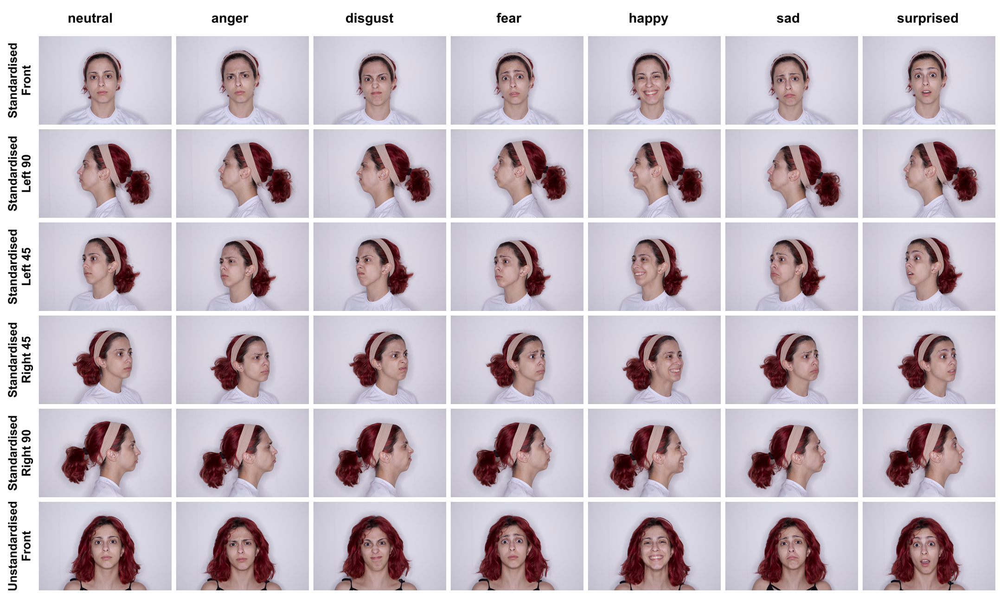

In [ ]:
knitr::include_graphics("fig/img-examples.png")

#### Model Demographics

In [ ]:
# count faces per ethnicity category
eth_rec <- count(data_models, ethnicity_rec, .drop = FALSE)
eth_n <- as.list(eth_rec$n)
names(eth_n) <- c(as.character(eth_rec$ethnicity_rec[1:7]), "NA")

For data cleaning, we first downloaded and reshaped the raw data from Experimentum. In the next step, we ensured that the models’ gender, race/ethnicity, and units of height and weight were consistently formatted across labs.

For gender and race/ethnicity, words presented in languages other than English were recoded to be presented in English (e.g., “mulher” to “female”, “preta” to “Black”). We then classified self-described race/ethnicity into one of seven categories (“White” (n = 89), “Black” (n = 5), “Asian” (n = 57), “Indigenous” (n = ), “MENA” (n = ) (Middle Eastern or North African), “Latine” (n = 10), or “Mixed” (n = 15)), where possible. Descriptions that could not be clearly sorted into these categories were given “Ambiguous label” (n = 7) and non-entries were recoded as NA (n = 12).

For height, we ensured all data were presented in centimeters, and for weight, we ensured that all data were presented in kilograms. Models could report height and weight in metric or imperial units, so we converted from imperial to metric where required. We also sanity-checked the reported units, assuming heights \> 100 to be in centimeters and those \< 100 to be in inches, and weights \< 80 to be in kilograms. Any non-entries of height or weight for a model was recoded as NA .

In [ ]:
data_models |>
  mutate(gender = gender_rec) |>
  summarise(
    .by = gender,
    n = n(),
    age_min = min(age, na.rm = TRUE),
    age_max = max(age, na.rm = TRUE),
    age_mean = mean(age, na.rm = TRUE),
    height_min = min(height_cm, na.rm = TRUE),
    height_max = max(height_cm, na.rm = TRUE),
    height_mean = mean(height_cm, na.rm = TRUE),
    weight_min = min(weight_kg, na.rm = TRUE),
    weight_max = max(weight_kg, na.rm = TRUE),
    weight_mean = mean(weight_kg, na.rm = TRUE)
  ) |>
  flextable() |>
  add_header_row(values = c("", "Age (years)", "Height (cm)", "Weight (kg)"),
                colwidths = c(2, 3, 3, 3)) |>
  set_header_labels(age_min = "min", 
                    age_max = "max",
                    age_mean = "mean",
                    height_min = "min", 
                    height_max = "max",
                    height_mean = "mean",
                    weight_min = "min", 
                    weight_max = "max",
                    weight_mean = "mean") |>
  colformat_char(j = 1, na_str = "missing") |>
  colformat_double(digits = 1) |>
  flextable::width(j = 1, width = 1)

The first warning was:
ℹ In argument: `age_mean = mean(age, na.rm = TRUE)`.
ℹ In group 1: `gender = "female"`.
Caused by warning in `mean.default()`:
! argument is not numeric or logical: returning NA
ℹ Run `dplyr::last_dplyr_warnings()` to see the 4 remaining warnings.

Age (years) Height (cm) Weight (kg) gender n min max mean min max mean min max mean female 124 18 65 149.0 180.3 164.9 37.0 108.9 62.9 male 78 18 80 163.0 193.0 178.3 54.0 130.0 79.6 non-binary 7 19 37 165.0 201.0 175.0 59.0 110.0 74.1 NA 1 27 27 169.0 169.0 169.0 61.0 61.0 61.0 missing 1 30 30 167.0 167.0 167.0 60.0 60.0 60.0

## Study/phase 2: Validation/norming data

We next obtained perceptions/ratings of a subset of the photos (front-facing) to validate the emotion expressions (their perceived emotion category and intensity) and collect norming data on central social perceptions, namely perceived attractiveness, dominance, trustworthiness, gender-typicality, memorability, and age. We chose these ratings due to their central importance in the person perception, face recognition, and emotion perception literatures \[e.g., @bainbridge_intrinsic_2013, @jack_four_2016, @oosterhof_functional_2008; @sutherland_social_2013; @perrett_your_2017\]. We preregistered this study on the OSF (<https://osf.io/4d5v9>).

### Method

#### Image Processing

RAW images were processed using webmorphR \[@debruine_reproducible_2022\], which facilitates scriptable processing of images using imagemagick \[@imagemagick\]; a full script of the processing steps is available at \[REPO <!--add link-->\]. Briefly,

-   Each face was delineated using the Face++ automatic face detection algorithm (see <https://www.faceplusplus.com/>) to generate a 106-point template.
-   All images were resized to 1000w by 1500h pixels to standardise size (two different RAW formats were used, which resulted in two different image sizes)
-   The median RGB colour value of a 100×100 pixel patch at the upper left corner was calculated to fill in any edges from alignment.
-   The image was repositioned and cropped (not rotated or resized) such that
    -   The image size was 675w by 900h pixel
    -   point 71 (between the eyes) was relocated to position \[.5w, .4h\]
-   This aligned image was saved as a lossless PNG using imagemagick default settings (e.g., sRGB colour space).
-   A white balance correction was applied to the resulting images, calculated from the mean RGB values in the 25x25 pixel top-right corner patch (white background) [1]
-   These images were converted to JPEGs with a quality setting of 75 to reduce file size for stimulus display online.

[1] We did not fully colour-calibrate the images here (see Discussion) but future researchers may wish to do so.

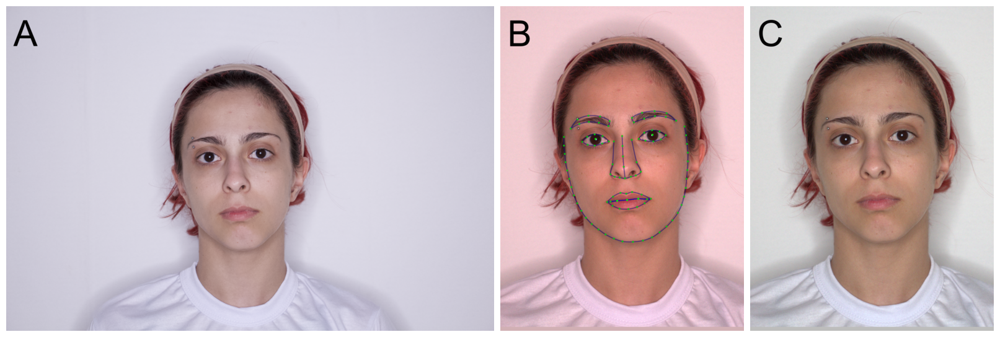

In [ ]:
knitr::include_graphics("fig/img-processing.png")

#### Stimuli

In [ ]:
# count images for each emotion and unstandardised
emo_n <- as.list(image_type_n$std)
names(emo_n) <- image_type_n$emotion
unstd <- image_type_n$unstd[[1]]

The number of stimuli was determined by the number of models recruited across the 20 research labs and how many models posed for each image type. The maximum number of targets per image type was 205[1], meaning each rater saw up to 205 stimuli. We obtained ratings of the front-facing standardised neutral (n = 205), unstandardised neutral (n = 177), standardised angry (n = 187), standardised disgusted (n = ), standardised fearful (n = 175), standardised happy (n = 199), standardised sad (n = 183), and standardised surprised (n = 184).

[1] The preregistration mis-stated the total number of models, rather than the maximum number of images, to be 205. The total number of models was 211

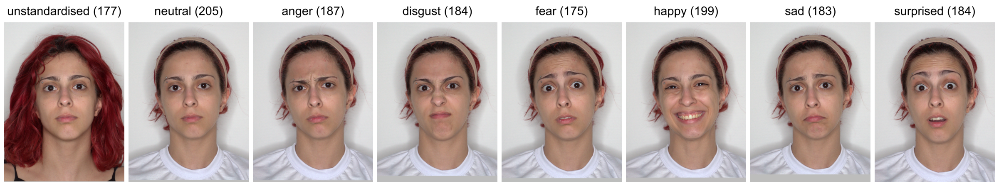

In [ ]:
knitr::include_graphics("fig/stim-types.png")

#### Attention Check Stimuli

Additionally, we created stimuli for attention checks. These were white images with the same size and aspect ratio as the face stimuli, but contained only the written instruction to choose a specific response, (e.g., ‘Choose “fear”’ or ‘Choose “3”’).

#### Measures

##### Standardised Neutral Faces

###### Trait Ratings

We obtained ratings of faces’ attractiveness, dominance, trustworthiness, memorability, and gender-typicality (‘How attractive \[dominant, trustworthy, memorable, gender-typical\] does this person look?’). Ratings were on scales ranging from 1 (*not at all*) to 7 (*very*).

###### Demographic Impressions

We obtained ratings of faces’ perceived age (‘How old does this person look?’), with responses collected in 5-year ranges/brackets (i.e., 16-20, 21-25, …, 76-80, 81+).

##### Unstandardised Neutral Faces

###### Trait Ratings

We obtained ratings of faces’ attractiveness, dominance, and trustworthiness on scales ranging from 1 (*not at all*) to 7 (*very*).

##### Standardised Emotional Faces

###### Emotion Categorisation

We obtained impressions of the emotion each person was expressing (‘What emotion is this person expressing?’), choosing one from: *anger, disgust, fear, happiness, sadness, surprise, other*. Here, raters categorized a counterbalanced mixture of expressions (from one of six counterbalanced conditions) rather than faces all showing the same expression. The 201 identities with emotion images were divided into six groups of up to 34 images, and each counterbalanced condition showed a different emotion for each of the six groups, such that no identity was shown more than once to each rater. Since not all identities had all six emotions, the number of images in each counterbalanced condition ranged from 179 to 193.

###### Emotion Intensity Ratings

We obtained ratings of how intensely faces expressed each intended emotion (‘How intensely is this person expressing anger \[disgust, fear, happiness, sadness, surprise\]?’) from 1 (*not at all)* to 7 (*very*). Here, raters only rated all faces showing one emotion expression (e.g., all angry faces) and rated the intensity only of the intended expression (e.g., angry faces only rated on anger intensity).

#### Procedure

We collected ratings via Experimentum \[@debruine_experimentum_2020\]; structure files for the exact experimental setup are available at \[REPO\]<!--add link-->. After a brief introduction to the study and online informed consent, each participant (rater) was randomly allocated to one of the ratings (e.g., rating all 205 standardised neutral faces on how memorable they look). All available faces were displayed one at a time, in a randomised order for each rater. The question/prompt and response scale remained visible at the top of the screen, above the photo throughout the study. The study automatically progressed to the next trial once the rater responded by clicking on the response scale. There was no time limit to provide a response. We included seven attention checks embedded in the study, which directed raters to provide a specific response.

Following rating or categorising all stimuli, raters self-reported their gender, age, race/ethnicity, country of residence, and device type used for the study (desktop, laptop, tablet, mobile)<!--add doc to OSF-->. They also completed an honesty/attention check question, asking them if they engaged with the study seriously, with assurance of payment regardless of response (choosing from ‘no, I was not really paying attention’ and ‘yes, I tried to give my authentic first impressions’).

We recruited fluent English-speaking raters through Prolific <!--add prolific inclusion/exclusion criteria-->. We collected all data in May 2025[1].

#### Participants

We aimed to collect 100 raters per rating condition to achieve stable averages and allow for exclusions \[@hehman_assessing_2025\], totalling 2100 raters. Altogether, 2115 raters completed the study. See Results for exclusions and demographics of the final sample.

### Results

#### Data Cleaning and Exclusions

In the raters’ demographic questionnaire, we standardized participants’ recording of their race/ethnicity similarly to the models’ by recoding their inputs into one of seven categories (“White”, “Black”, “Asian”, “Indigenous/Pacific Islander”, “MENA” (Middle Eastern or North African), “Latine”, or “Mixed”), or as “Ambiguous label” when this was not possible. Any non-entries were recoded as NA.

A total of 2115 raters completed 2158 rating or categorisation tasks. We found that some raters did not complete all trials in tasks, some raters completed more than one task, and some raters completed more than the maximum number of trials in a task (likely by restarting the study or bypassing the back button block). Therefore, we removed incomplete tasks from our data, retained raters’ first complete tasks, and filtered our duplicate trials by keeping only raters’ first ratings for a duplicated trial. After these exclusions, and before implementing the pre-registered plan for data exclusions, we had complete and clean data from 1936 raters.

Our pre-registered plan for data exclusions included removing raters who gave overly consistent responses, committed overly fast responses, self-reported not taking the study seriously when asked whether or not they completed the study authentically, and failed attention checks. In total, we excluded 49 raters for our pre-registered reasons for data exclusions. @tbl-exclusions shows the number of raters we excluded for each of our reasons.

[1] This was slightly later than preregistered, due to pretesting and study setup delays.

In [ ]:
# tbl-subcap: Multiple raters met more than one exclusion criterion; therefore, the counts for individual criteria do not sum to the total number of raters excluded.

exclusions |> 
  summarise(
    `Overly consistent` = sum(!is.na(same_pcnt)),
    `Overly fast` = sum(!is.na(med_rt)),
    `Failed honesty check` = sum(!is.na(honesty_check)),
    `Failed attention checks` = sum(!is.na(attn_checks_passed)),
    `Total` = n()
  ) |> 
  pivot_longer(
    cols = everything(),
    names_to = "Reason for exclusion",
    values_to = "N"
  ) |>
  flextable() |>
  flextable::width(j = 1, 2)

Reason for exclusion,N
Overly consistent,13
Overly fast,20
Failed honesty check,2
Failed attention checks,19
Total,49


We defined overly consistent responses as those raters who responded to at least 90% of the trials identically. We defined overly fast responses as those raters whose median reaction time fell below the 1st percentile of the overall distribution of median reaction times (see Figure 1 for the distribution of median reaction times). For our attention checks, the threshold for inclusion was to accurately complete six or more attention checks (i.e., participants were excluded if they failed more than one of the checks). After these exclusions, we had 1887 raters in our sample (see @tbl-raters-per-task for the number of raters per task).

*QU: should section mention additional overly consistent exclusions and self-reported honesty checks?*

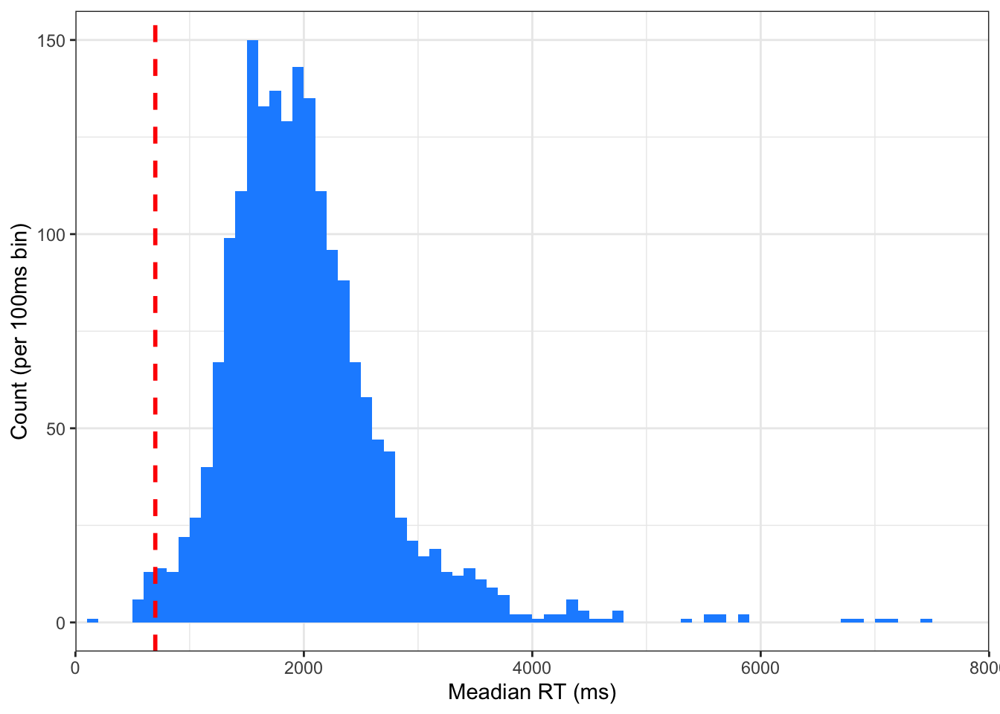

In [ ]:
med_rt |> 
  ggplot(aes(x = med_rt)) +
  geom_histogram(binwidth = 100, boundary = 0, fill = "dodgerblue") +
  geom_vline(xintercept = quantile(med_rt$med_rt, probs = 0.01), 
             color = "red", linetype = "dashed", linewidth = 1) +
  coord_cartesian(xlim = c(0, 8000)) +
  scale_x_continuous(expand = expansion(mult = 0)) +
  labs(x = "Meadian RT (ms)",
       y = "Count (per 100ms bin)")  +
  theme_bw()

In [ ]:
data_exp |>
  summarise(.by = exp,
            raters = unique(session_id) |> length()
            ) |>
  arrange(exp) |>
  flextable() |>
  set_header_labels(exp = "Rating Task",
                    raters = "N Raters") |>
  flextable::width(j = 1, 2)

Rating Task,N Raters
age,85
anger,84
attractive,84
attractive (unstd),84
disgust,91
dominant,91
dominant (unstd),94
emotion 1,97
emotion 2,87
emotion 3,88


Anonymous data are available on the OSF: \[LINK\] <!--[add link-->

#### Rater Demographics

In [ ]:
n_demog_provided <- data_quest$session_id |> unique() |> length()

We collected the following demographic data from our raters (N = 1652 provided data): Age, gender, residence, ethnicity, and devices on which the ratings were completed. See @fig-gender-age and Tables 3-5 for demographic information.

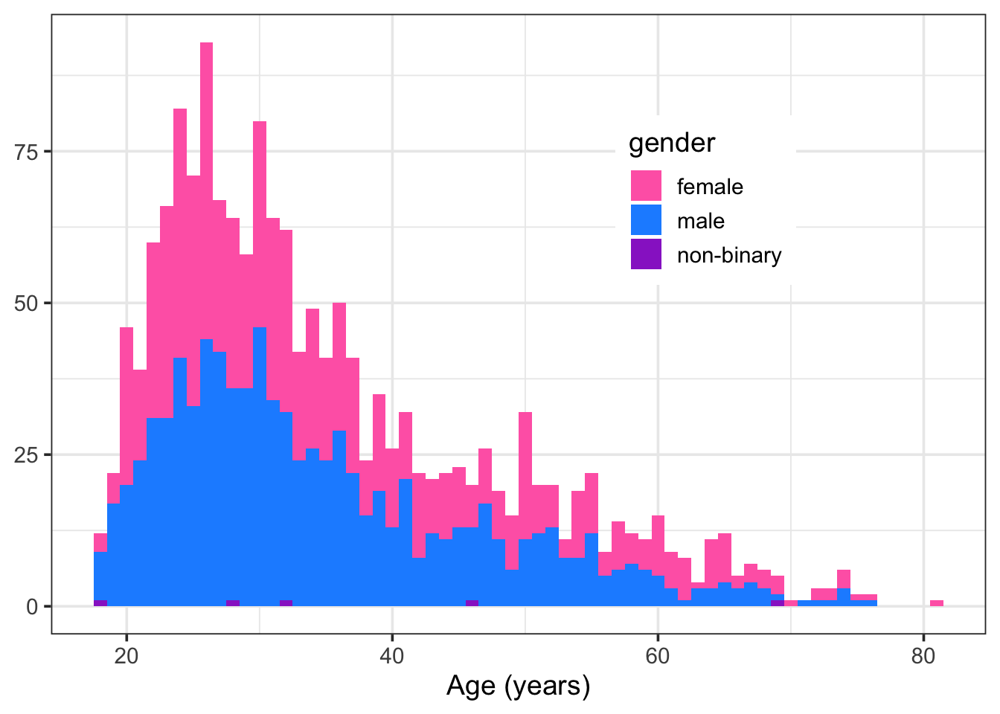

In [ ]:
data_quest |> 
  ggplot(aes(x = age, fill = gender)) +
  geom_histogram(binwidth = 1) +
  scale_fill_manual(values = c("hotpink", "dodgerblue", "darkorchid", "gray")) +
  guides(fill  = guide_legend(position = "inside")) +
  theme(legend.position.inside = c(.7, .7)) +
  labs(x = "Age (years)", y = NULL)

In [ ]:
data_quest |> 
  count(residence) |>
  summarise(.by = n, res = paste(residence, collapse = ", ")) |>
  arrange(desc(n)) |>
  select(res, n) |>
  flextable() |>
  set_header_labels(res = "Country of Residence", n = "N") |>
  flextable::width(j = 1, 2)

Country of Residence,N
ZA,822
GB,254
US,221
PL,49
PT,44
CA,41
ES,34
IT,27
KE,26
GR,19


In [ ]:
data_quest |> 
  count(ethnicity_rec) |>
  arrange(desc(n)) |>
  flextable() |>
  colformat_char(na_str = "Missing") |>
  set_header_labels(ethnicity_rec = "Ethnicity", n = "N") |>
  flextable::width(j = 1, 2)

Ethnicity,N
Black,928
White,580
Asian,69
Latine,34
Mixed,28
Ambiguous label,16
MENA,5
Indigenous / Pacific Islander,3
Missing,2


In [ ]:
data_quest |> 
  count(device) |>
  arrange(desc(n)) |>
  flextable() |>
  colformat_char(na_str = "Missing") |>
  set_header_labels(device = "Device Used", n = "N") |>
  flextable::width(j = 1, 2)

Device Used,N
laptop,743
desktop,465
phone,418
tablet,37
Missing,2


#### Agreement Indicators for the Ratings

##### Standardized Trait Ratings

In the first step, we calculated intraclass correlations for traits observed across tasks for our standardized images. The number of raters ranged from 83 to 94 for these traits. The average reliability across raters was very good for rating attractiveness, dominance, trustworthiness, and gender-typicality, but poorer for rating memorability (see @tbl-std-neu-agree).

In [ ]:
# tbl-subcap: ICCs values are ICC (2,k) values.

data.frame(1:5)

Next, we examined the number of raters required for trait ratings to reach stable levels of reliability defined as ICC (2,k) values of 0.75 and 0.90 (see Figure 3). Attractiveness ratings stabilized with the fewest participants, reaching an ICC (2,k) of 0.75 at approximately 18 raters. It was also the only trait to exceed an ICC (2,k) of 0.90, which occurred with 50 raters. Ratings for dominance, trustworthiness, and gender-typicality reached an ICC (2,k) of 0.75 with approximately 35-40 raters (see @fig-icc-cos).

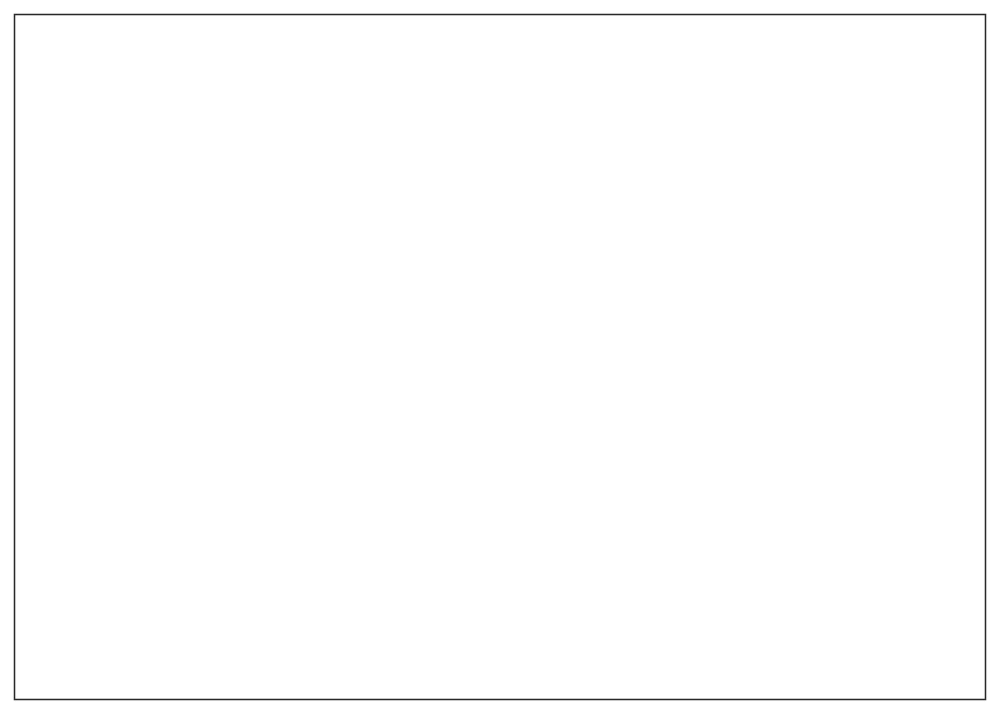

In [ ]:
ggplot()

For checking internal consistency of our ratings, we used both Cronbach’s alpha (α) and McDonald’s omega total (ωt) (see @tbl-std-neu-agree). For four of the five traits, both α and ωt exceeded 0.9, indicating excellent internal consistency. For the fifth trait (memorability), α was lower (0.65), indicating doubtful internal consistency when assuming equal item contributions (tau-equivalence) in the ratings. However, ωt for memorability was substantially higher (0.87), indicating good internal consistency after taking into account variance among item or rater contributions.

##### Unstandardized Trait Ratings

As with our standardized trait ratings, but for three rather than five traits, we calculated intraclass correlations for ratings to our unstandardized images observed across rating tasks. The number of raters ranged from 84 to 95 for these traits. The The average reliability across raters was very good for all trait ratings (see @tbl-unstd-neu-agree). All three traits also demonstrated excellent internal consistency (see @tbl-unstd-neu-agree) with Cronbach’s alpha (α) ranging from 0.88 to 0.95 and McDonald’s omega total (ωt) ranging from 0.90 to 0.96.

In [ ]:
# tbl-subcap: ICCs values are ICC (2,k) values.

data.frame(1:5)

##### Emotion Intensity Ratings

Next, we calculated the intraclass correlations and internal consistency metrics for our emotion intensity ratings. The number of raters ranged from 84 to 103 for our six emotions. The average reliability across raters was excellent for all of the emotions, with ICC (2,k) ranging from 0.95 to 0.98. Internal consistency was also excellent for all emotions in terms of Cronbach’s alpha (α = 0.97 to 0.99) and McDonald’s omega total (ωt = 0.97 to 0.99; see @tbl-emo-agree).

In [ ]:
# tbl-subcap: ICCs values are ICC (2,k) values.

data.frame(1:5)

#### Points of Stability

To determine the number of raters required for stable ratings, we computed the point of stability (Hehman et al., 2025). This approach estimates the smallest sample size at which mean ratings stabilize by exceeding a cosine similarity threshold of 0.5 with the full-sample mean. As shown in Figures 4-6, the ratings to the standardized images reached stability between 37 and 45 raters, the ratings to the unstandardized images reached stability between 37 and 42 raters, and the ratings for the emotion intensities reached stability between 29 and 50 raters.

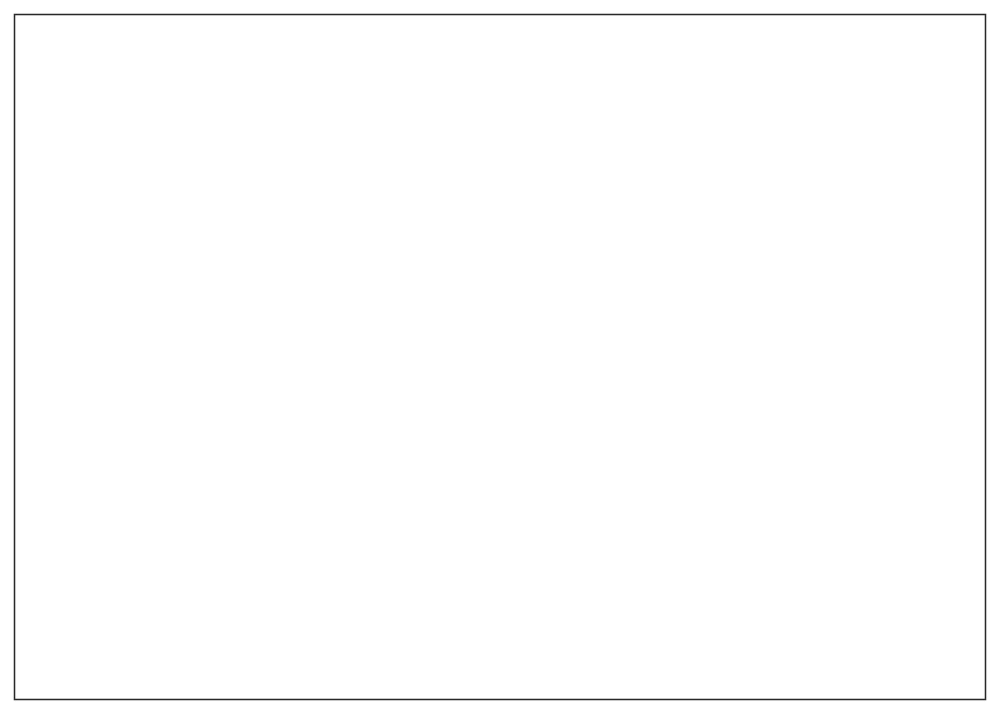

In [ ]:
ggplot()

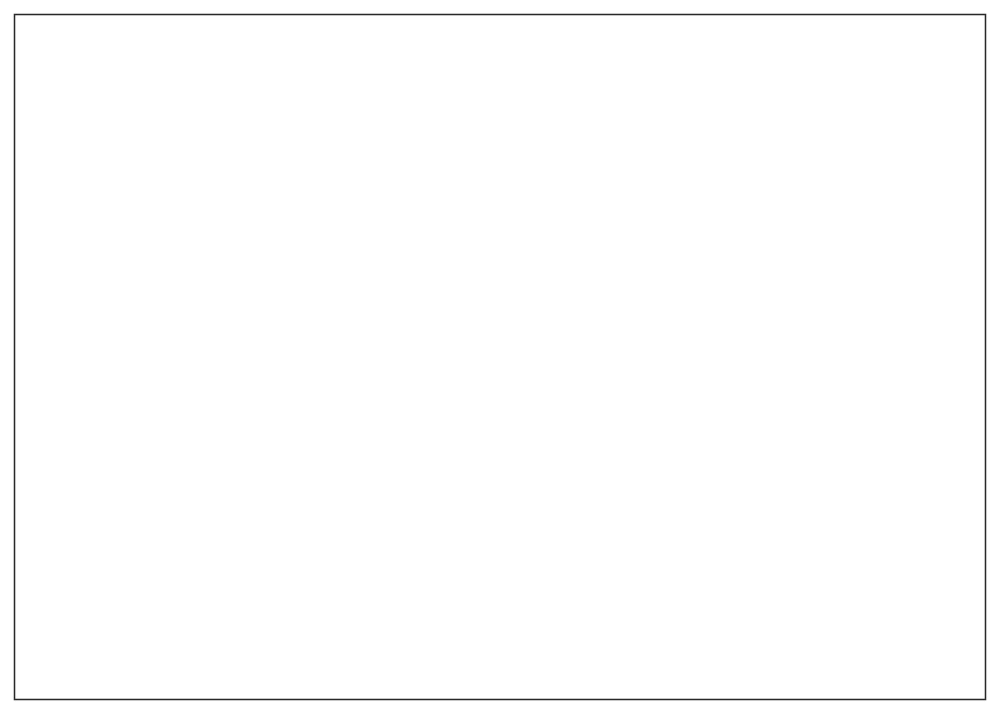

In [ ]:
ggplot()

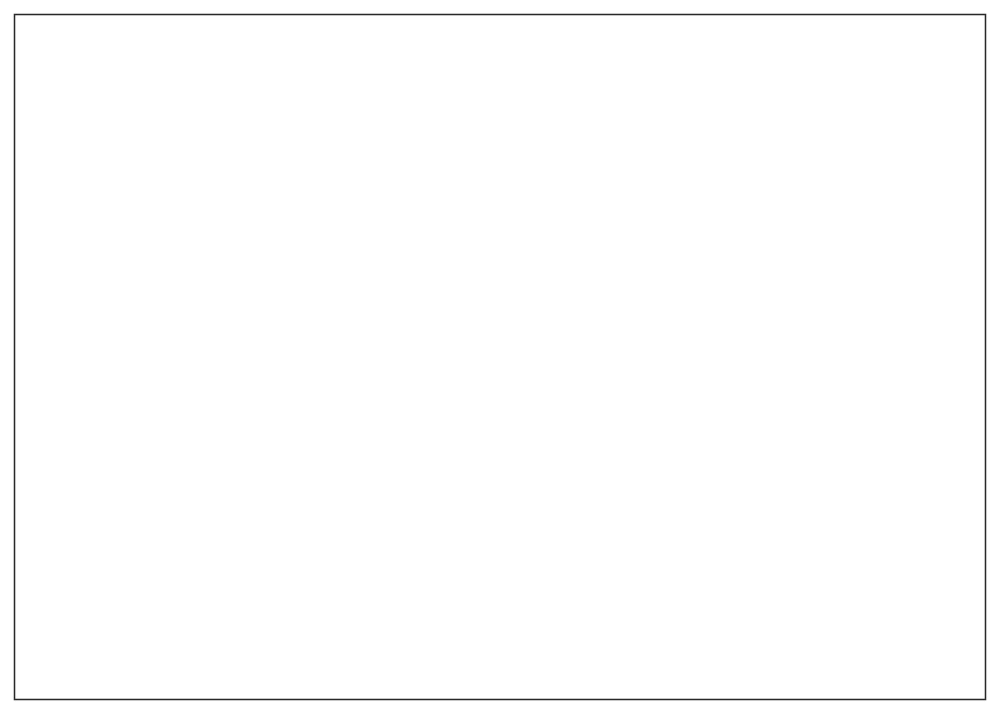

In [ ]:
ggplot()

#### Descriptive Statistics

In this section, we report the descriptive statistics for ratings of the neutral standardized images, the neutral unstandardized images, the emotion categorization task, the intensity of expressed emotions, and the ages of the models.

##### Standardized Neutral Trait Ratings

Trustworthiness, dominance, and memorability ratings were approximately normally distributed and showed similar patterns of central tendency and variance. In contrast, attractiveness ratings were somewhat right-skewed, reflected in a relatively lower mean, while gender-typicality ratings were left-skewed, with a relatively higher mean (see @tbl-std-neu-desc for descriptive statistics and @fig-std-neu-hist for rating distributions).

In [ ]:
data.frame(1:5)

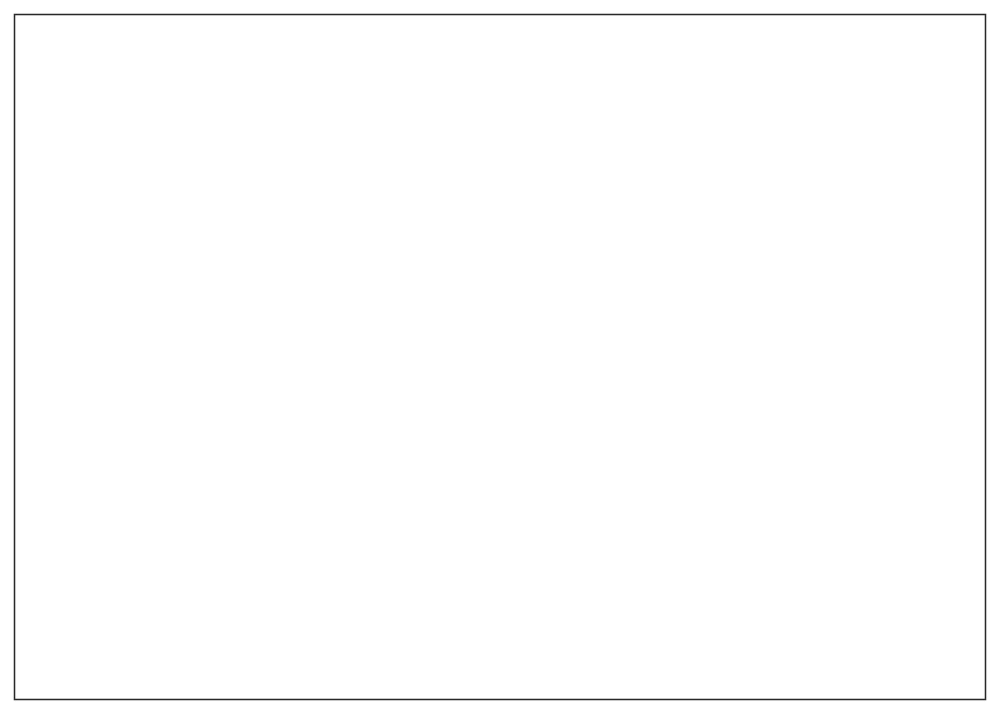

In [ ]:
ggplot()

A key aim of this study was to provide normative data for each face model in the database. To visualize rating patterns, we created heatmaps with rating values on the x-axis and face models (separated by contributing lab site) on the y-axis. These heatmaps illustrate how the distribution of ratings varied across models and traits, with lighter tiles indicating that more raters gave a particular rating to that model (see Appendix) — capturing both between-model differences within a trait and within-model differences across traits.

##### Unstandardized Neutral Trait Ratings

The ratings for dominance were approximately normally distributed, whereas the ratings for attractiveness were slightly skewed right and the ratings for trustworthiness were slightly skewed left, each reflected in their relatively low and high mean ratings (see @tbl-unstd-neu-desc for descriptive statistics and @fig-unstd-neu-hist for rating distributions).

In [ ]:
data.frame(1:5)

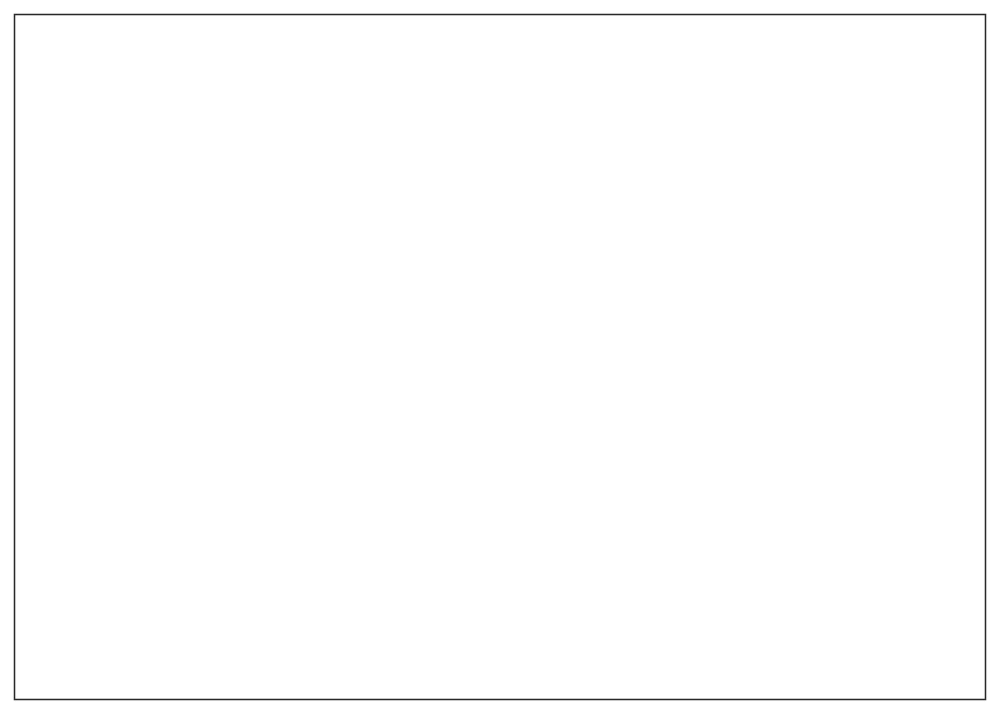

In [ ]:
ggplot()

As with the ratings of the standardized images, we produced heatmaps for each of the three traits capturing between-model differences within a trait and within-model differences across the traits (see Appendix).

##### Emotion Categorization and Intensity Ratings.

Next, we explored raters’ emotion categorizations and perceived emotion intensity expressed by our models. Raters’ categorizations generally aligned with the models’ expression of emotion, with the greatest alignment was observed for expression of happiness, and the least for fear (@tbl-emo-desc, @fig-emo-freq).

In [ ]:
# tbl-subcap: Note. Italicised values indicate correct categorisations (categorisations matching intended model expression).

data.frame(1:5)

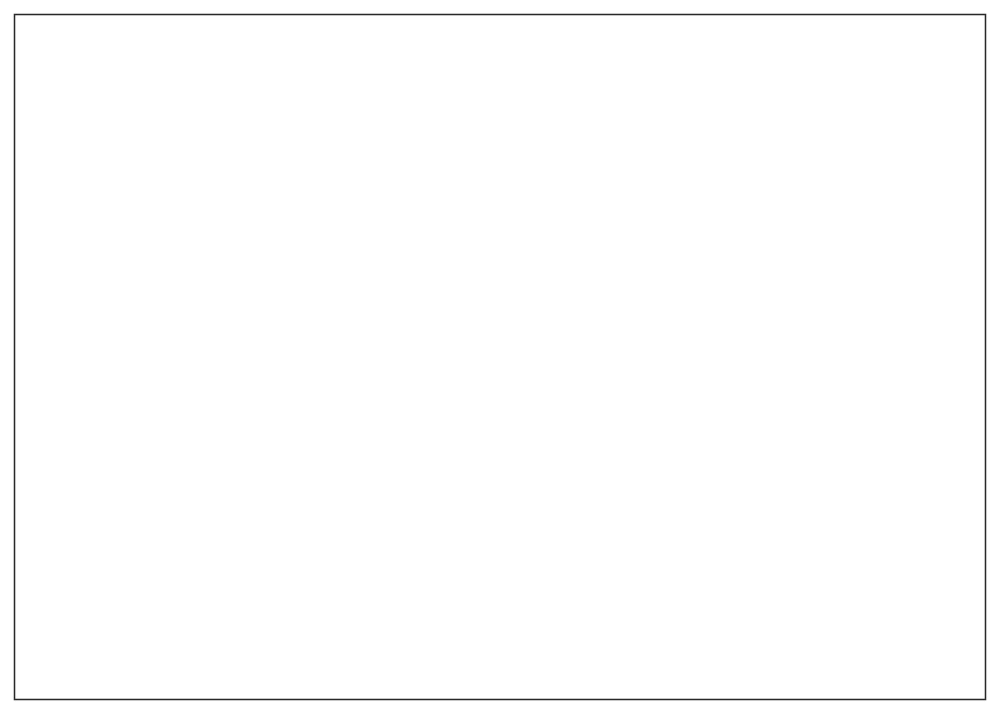

In [ ]:
ggplot()

Next, we calculated the average ratings of emotion intensity for each emotion (@tbl-intensity-desc). These ratings were very similar, on average, between the different emotions except for happiness, which was rated with greater intensity than all other emotions. On average, these ratings were located around the middle of the 7-point scale. @fig-intensity-hist shows the distribution of ratings on the scale for each emotion.

In [ ]:
data.frame(1:5)

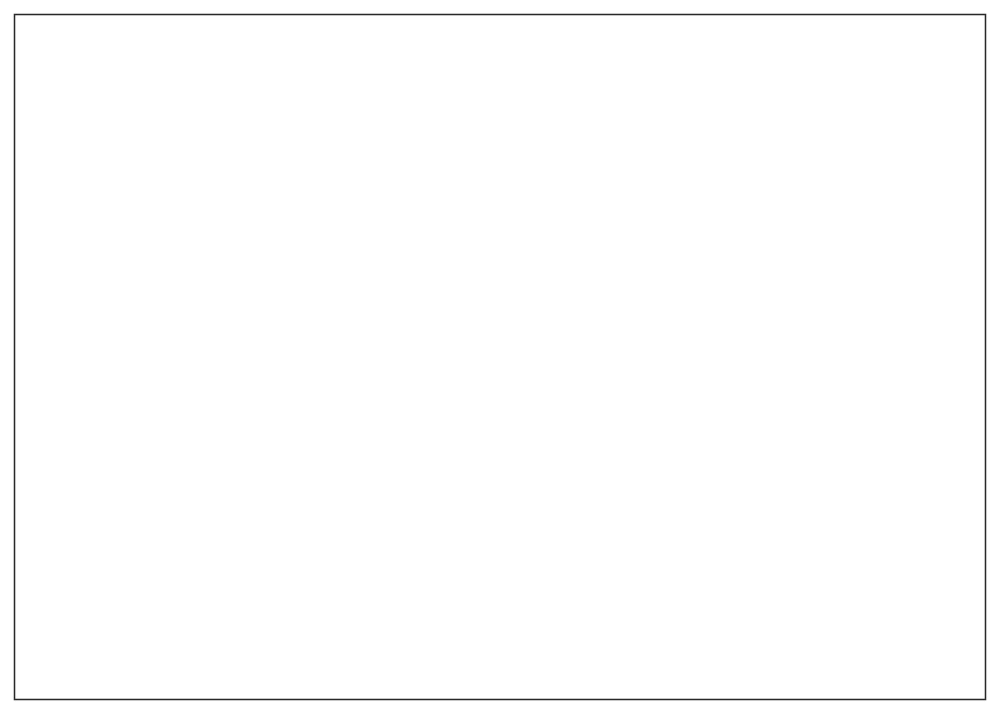

In [ ]:
ggplot()

##### Perceived Age

The distribution of raters’ perceptions of models’ ages is shown in @fig-age-hist. 26-30 years was the most-chosen age across raters and models. The correlation between models’ mode perceived age and actual age appears in @fig-age-corr, and heatmaps of perceived age for each model appear in the Appendix.

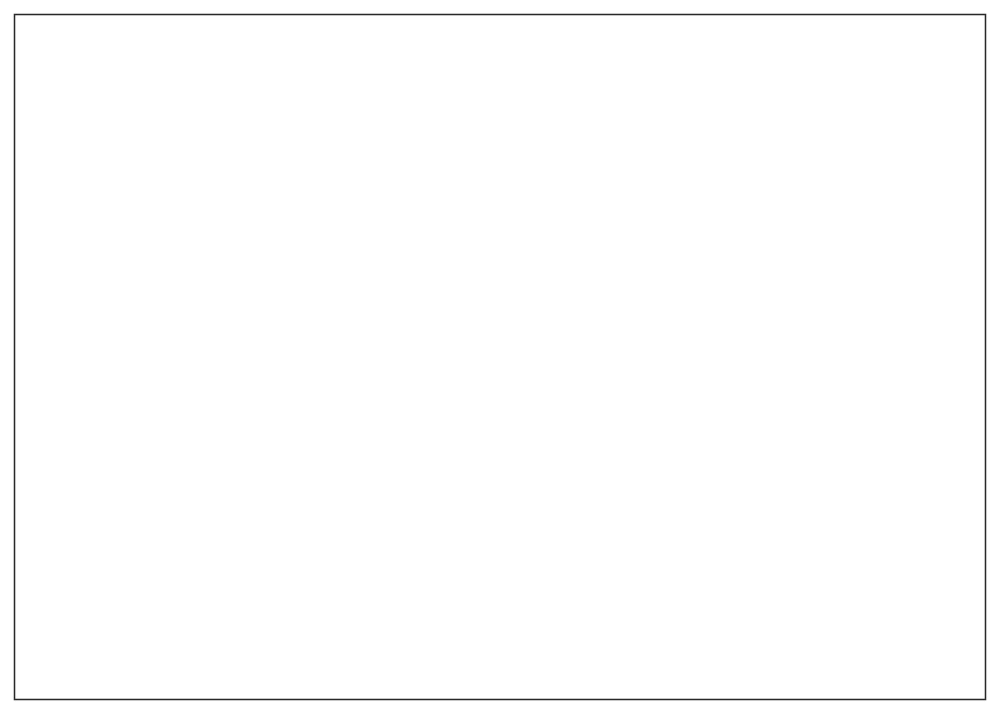

In [ ]:
ggplot()

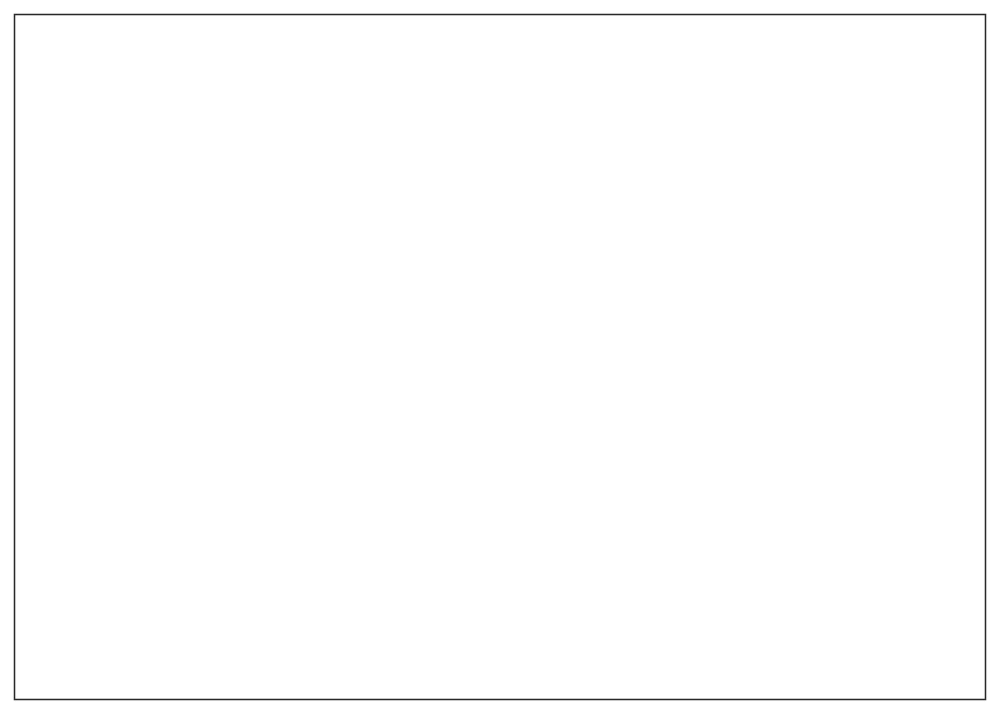

In [ ]:
ggplot()

#### Exploratory Inferential Statistics

##### Standardized vs Unstandardized Neutral Trait Ratings

Compare attractiveness, dominance, and trustworthiness ratings across level of standardization for models w/ both kinds of photo (3 t-tests)

##### Emotion Categorizations

Compare the ‘correct’ proportions across expression type (i.e., to show that happiness is perceived significantly more correctly & fear significantly more inaccurately than the others)

##### Emotion Intensity Ratings

Compare emotion intensity ratings across expression type (i.e., to show that happiness appears most intense)

## Discussion

### The value of the current work

This database provides a uniquely diverse face image stimulus set in terms of model nationality and image variety (appearance standardization, viewing angle, and facial expression). The diversity of images within the database makes it potentially useful to address a variety of research questions in multiple subfields of psychology (e.g., face recognition, emotion). It accomplishes this while being transparent and reproducible via the openly available protocol. Additionally, the database need not remain static: Other researchers can follow the protocol and add to the database, further increasing its sample size and diversity. This protocol can also serve as a template for researchers interested in collecting stimulus images, in terms of highlighting the kinds of details that need to be considered and documented)

The data associated with the images are also valuable. First, we collected models’ self-reported demographic information, which is useful for various kinds of research questions. The validation/norming data we collected also provide a useful starting point for researchers interested in using the images, for example enabling researchers to choose subsets of images most suited to address their research questions. These data also provide information about the minimum number of raters needed for reliable mean ratings for different judgments \[see @hehman_assessing_2025\].

This work also provides proof of concept that various labs, all following the same protocol and using the same equipment, can take comparable images to form a coherent face database. This broadens opportunities for future image database collection: A database does not need to all be collected by one lab in one location.

### Reflections on the Process & Limitations

The leadership team found that having a broad variety of areas of expertise and diverse research backgrounds within the broader team was invaluable in both developing the database and in troubleshooting issues. We moreover found that setting out expectations at the start of the project through a collaboration agreement was essential. However, we ran into various issues throughout the process, which are common to Big Team Science initiatives. For example, with so many labs and individual researchers involved, timelines for completion necessarily stretched. This made momentum difficult to maintain at times. Planning in generous buffer time for such large-scale projects and managing team members’ expectations around timelines is therefore essential. We also faced difficulty in finding an optimal way to communicate effectively with all team members, given varying preferences (e.g., via email vs. other team communication platforms). It is perhaps worth surveying members of a big team at project start about communication possibilities, as well as outlining more specific communication expectations in a collaboration agreement.

After Phase 1, we surveyed the ManyFaces research team to provide feedback on the process of collecting images using the protocol. Team members commonly expressed the desire for additional concise guidance in following the protocol, including an additional abbreviated protocol with numbered steps to follow during data collection and a video tutorial (in addition to the provided illustrative images) showing the necessary steps for researchers unfamiliar with camera equipment. These are requests that we can incorporate into future protocol updates. Doing so could both make the process easier for researchers and minimize errors and deviations from the protocol, ensuring greater consistency between sites.

The major issue raised by the research team was the difficulty of eliciting facial expressions as described in the protocol. The protocol took a straightforward instructive approach to emotion elicitation (e.g., asking participants to face the camera with the expression they would make if they were feeling happy), following consultation with emotion experts in ManyFaces and discussion of feasibility with the wider team. However, models self-reported difficulty with the facial expression posing, in line with researchers’ feedback. The emotion validation data also indicate that models struggled to pose the facial expressions of emotion. The data furthermore suggest that perceivers had difficulty identifying emotions from these posed facial expressions. In support of this idea, recent research shows posed expressions to not appear genuine and reveals differing perceptions of posed and spontaneous expressions \[@dawel_perceived_2017; @dawel_faking_2025\]. Future work, including possible updates to our own protocol, may therefore focus on developing a better framework to elicit facial expressions. This could include taking inspiration from databases of naturally-induced emotion \[e.g., @miolla_padova_2023; @sneddon_belfast_2012\] and considering potential cultural differences and specific local needs.

The research team also raised several comments about the provided and not-provided equipment, specifically the flimsiness of the light stand and the missing standardized backdrop (due to shipping constraints, participating researchers were to source a white background, e.g., a wall, seamless fabric, or paper). It is worth highlighting that the images were captured with equipment selected due to several practical constraints: budget, university-approved vendors, shipping logistics, interoperability, and ease of use for non-experts in varying conditions. The available project budget and administrative restrictions on approved vendors (their offerings and stock) for the University of Glasgow primarily limited the attainable camera, lens, and lighting setup. In general, we opted to create a setup that would not be prohibitively expensive to acquire, could be shipped in a single parcel, and would be compatible (substitutable) with equipment other researchers may have available. The last consideration was creating a setup with the fewest degrees of freedom, and thus less room for error. Therefore, we opted to use an LED ring light with a camera mounted inside the ring in landscape orientation on a single stand (vs. portrait orientation using a different kind of mount or separate stands for the camera and light). Ring lights became ubiquitous and easy to acquire in recent years; they only need to be positioned square, level, and in front of the sitter. Other, more complex setups can be created; however, the price, mobility, and repeatability of such setups may represent major constraints to consistent and reliable image collection. It is therefore worth considering trade-offs between different kinds of equipment and setups in future work.

In addition to our choices of equipment, we also made certain pragmatic choices during image processing that future work could improve on. For example, we white-balanced the images rather than fully colour-correcting them, as we were able to create a fully reproducible scripted method for the former process, but not the latter. This was due to limitations such as varied colour checker chart placement and orientation in models’ photos and a lack of expertise on the research team to work around this in a reproducible way. We therefore opted to simply white-balance to keep the process entirely open and reproducible, rather than fully colour-correct using a manual and not fully reproducible method. The process of aligning and sizing the images was also driven by cropping needs. That is, due to the landscape orientation of the photos, there was limited vertical space that we could crop, constraining the possibilities for face alignment and image size. Future work could consider using alternative equipment setups to enable capture images in portrait mode. Variation in faces’ size in the images, due to some deviations from the distances specified in the protocol, also affected the image processing steps. This could be addressed in future work by more clearly highlighting not only the key aspects of the protocol that should be kept constant, but also why these aspects should be constant (i.e., clarifying the reasoning to all team members).

Finally, we collected images of 211 models, but no single image type included images of all models. Rather, the maximum number of models represented in a single image type was 205 images (standardized neutral, front-facing). This led to missing perceived age/ethnicity data for six models who had unstandardized but not standardized neutral images available.

### Conclusion

Here, we introduce a new diverse face image database, which will be useful to researchers interested in a variety of questions related to social perception, person recognition, and vision science. We demonstrate that a cohesive database can be compiled across a variety of sites, opening doors for future additions to this database and the development of future multi-lab databases.